In [34]:
import seaborn as sns
import pandas as pd
from Utils import utils
import cufflinks as cf
import matplotlib.pyplot as plt
from plotly import __version__
from plotly.offline import download_plotlyjs,init_notebook_mode,plot,iplot
import numpy as np

In [2]:
print(__version__)
init_notebook_mode(connected=True)
cf.go_offline()
%matplotlib inline

2.2.2


# Getting most recent file and read

In [3]:
Extract = utils()      
dataframe = Extract.GetLastPickle()

In [4]:
dataframe.head(5)

,0,1,2,3,4,5,6,7,8,9,...,2022,2023,2024,2025,2026,2027,2028,2029,2030,Label
0,0.004348,0.004743,0.004743,0.004743,0.004743,0.004743,0.004743,0.004743,0.004743,0.004743,...,0.005138,0.005138,0.005138,0.004743,0.004743,0.005138,0.005138,0.005138,0.004743,oxigenio
1,0.004743,0.004743,0.004743,0.004743,0.005138,0.005138,0.005138,0.004743,0.004743,0.004743,...,0.005138,0.005138,0.005138,0.005138,0.004743,0.004743,0.004743,0.005138,0.005138,oxigenio
2,0.004348,0.004348,0.004743,0.004743,0.004743,0.005138,0.004743,0.004743,0.004743,0.004743,...,0.004743,0.004743,0.004743,0.004743,0.004743,0.004743,0.004348,0.004743,0.004743,oxigenio
3,0.004743,0.005138,0.005138,0.005138,0.005138,0.004743,0.004743,0.004743,0.004743,0.005138,...,0.004743,0.004743,0.004743,0.004743,0.004743,0.004743,0.004743,0.004743,0.004743,oxigenio
4,0.004743,0.004743,0.004743,0.005138,0.005138,0.005138,0.004743,0.004743,0.004348,0.004348,...,0.004348,0.004348,0.004348,0.004743,0.004743,0.004743,0.004743,0.004743,0.004348,oxigenio


In [23]:
dataframe.iloc[0][:-1].idxmax()

1018

In [24]:
def middle_width(array):
    
    index_base = 1000
    target_percentage = 0.5
    timestep = 2e-10
    
    idx_max = array.idxmax()
    middle_target = array[idx_max]*target_percentage

    delta = array[idx_max] - middle_target
    left_index_upper = idx_max
    left_index_down = left_index_upper

    for i in reversed(range(idx_max-1)):
        delta_actual = array[i] - middle_target

        if(delta_actual <= delta and delta_actual > 0):
            delta = delta_actual
            left_index_upper = i
        else:
            left_index_down = i
            break

    delta = array[idx_max] - middle_target
    right_index_upper = idx_max
    right_index_down = right_index_upper

    for i in range(idx_max, len(array)):
        delta_actual = array[i] - middle_target

        if(delta_actual <= delta and delta_actual > 0):
            delta = delta_actual
            right_index_upper = i
        else:
            right_index_down = i
            break


    x1l = left_index_down
    x2l = left_index_upper

    x1R = right_index_upper
    x2R = right_index_down


    ml = (array[x1l]-array[x2l])/(x1l - x2l)
    mR = (array[x1R]-array[x2R])/(x1R - x2R)

    bl =  (array[x1l]-(x1l*ml))
    bR =  (array[x1R]-(x1R*mR))

    xL = (middle_target - bl)/ml
    xR = (middle_target - bR)/mR

    xLB = (array[idx_max]*0.1 - bl)/ml
    x0L = -1*bl/ml
    x0R = -1*bR/mR
    middle_width = abs(xL-xR)*timestep
    rising_time = abs(x0L-idx_max)*timestep
    base_delta = abs(x0L - x0R)*timestep
    if False:
        plt.figure(figsize=(10,6))
        plt.plot([x1l,x2l],[array[x1l],array[x2l]],'r-',[x2R,x1R],[array[x2R],array[x1R]],'r-',[xL,xR],[middle_target,middle_target],'g-',array,'b.')
        print("x1l={} y1l={} x2l={} y2l={} x1R={} x2R={} ml={} mR={} bl={} bR={} xL={} xR={} xLB={}".format(x1l,array[x1l],x2l,array[x2l],x1R,x2R,ml,mR,bl,bR,xL,xR,xLB))

    array['Middle Width'] = middle_width
    array['Rising Time'] = rising_time
    array['Base delta'] = base_delta
    return array

In [27]:
target = dataframe['Label']
dataframe = dataframe.iloc[:,dataframe.columns != 'Label'].apply(middle_width,axis=1)

In [28]:
dataframe.head()

,0,1,2,3,4,5,6,7,8,9,...,2024,2025,2026,2027,2028,2029,2030,Middle Width,Rising Time,Base delta
0,0.004348,0.004743,0.004743,0.004743,0.004743,0.004743,0.004743,0.004743,0.004743,0.004743,...,0.005138,0.004743,0.004743,0.005138,0.005138,0.005138,0.004743,1.100000e-08,5.799999e-09,1.100000e-08
1,0.004743,0.004743,0.004743,0.004743,0.005138,0.005138,0.005138,0.004743,0.004743,0.004743,...,0.005138,0.005138,0.004743,0.004743,0.004743,0.005138,0.005138,7.150000e-09,2.899999e-09,1.210000e-08
2,0.004348,0.004348,0.004743,0.004743,0.004743,0.005138,0.004743,0.004743,0.004743,0.004743,...,0.004743,0.004743,0.004743,0.004743,0.004348,0.004743,0.004743,7.000000e-09,2.600000e-09,1.140000e-08
3,0.004743,0.005138,0.005138,0.005138,0.005138,0.004743,0.004743,0.004743,0.004743,0.005138,...,0.004743,0.004743,0.004743,0.004743,0.004743,0.004743,0.004743,5.866667e-09,2.733333e-09,1.053333e-08
4,0.004743,0.004743,0.004743,0.005138,0.005138,0.005138,0.004743,0.004743,0.004348,0.004348,...,0.004348,0.004743,0.004743,0.004743,0.004743,0.004743,0.004348,1.420000e-08,6.399999e-09,1.420000e-08


In [30]:
dataframewt = dataframe.join(target)

In [72]:
dataframewt.head()

,0,1,2,3,4,5,6,7,8,9,...,2025,2026,2027,2028,2029,2030,Middle Width,Rising Time,Base delta,Label
0,0.004348,0.004743,0.004743,0.004743,0.004743,0.004743,0.004743,0.004743,0.004743,0.004743,...,0.004743,0.004743,0.005138,0.005138,0.005138,0.004743,1.100000e-08,5.799999e-09,1.100000e-08,oxigenio
1,0.004743,0.004743,0.004743,0.004743,0.005138,0.005138,0.005138,0.004743,0.004743,0.004743,...,0.005138,0.004743,0.004743,0.004743,0.005138,0.005138,7.150000e-09,2.899999e-09,1.210000e-08,oxigenio
2,0.004348,0.004348,0.004743,0.004743,0.004743,0.005138,0.004743,0.004743,0.004743,0.004743,...,0.004743,0.004743,0.004743,0.004348,0.004743,0.004743,7.000000e-09,2.600000e-09,1.140000e-08,oxigenio
3,0.004743,0.005138,0.005138,0.005138,0.005138,0.004743,0.004743,0.004743,0.004743,0.005138,...,0.004743,0.004743,0.004743,0.004743,0.004743,0.004743,5.866667e-09,2.733333e-09,1.053333e-08,oxigenio
4,0.004743,0.004743,0.004743,0.005138,0.005138,0.005138,0.004743,0.004743,0.004348,0.004348,...,0.004743,0.004743,0.004743,0.004743,0.004743,0.004348,1.420000e-08,6.399999e-09,1.420000e-08,oxigenio


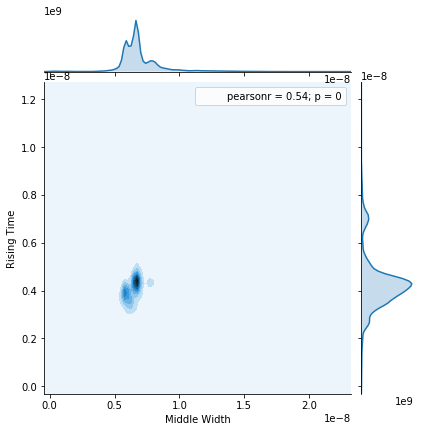

In [74]:
sns.jointplot(x='Middle Width',y='Rising Time',data=dataframewt,kind='kde')

# PCA

In [56]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

In [57]:
scaler = StandardScaler()

In [58]:
scaler.fit(dataframewt.loc[:, dataframewt.columns != 'Label'])

StandardScaler(copy=True, with_mean=True, with_std=True)

In [59]:
scaled_data = scaler.transform(dataframewt.loc[:, dataframewt.columns != 'Label'])

In [66]:
pca = PCA(n_components=2)

In [67]:
pca.fit(scaled_data)

PCA(copy=True, iterated_power='auto', n_components=2, random_state=None,
  svd_solver='auto', tol=0.0, whiten=False)

In [68]:
x_pca = pca.transform(scaled_data)

In [69]:
dfxpca = pd.DataFrame(x_pca)

In [70]:
df_comp = pd.DataFrame(pca.components_)

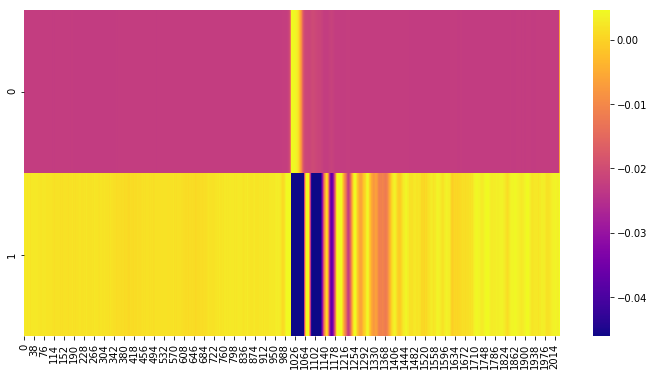

In [71]:
plt.figure(figsize=(12,6))
sns.heatmap(df_comp,cmap='plasma',robust=True)

In [7]:
datanew = pd.read_csv("../../analise_mestrado/novo_database/RefWaveforms/RefCurve_2014-06-05_13_174058.Wfm.csv")

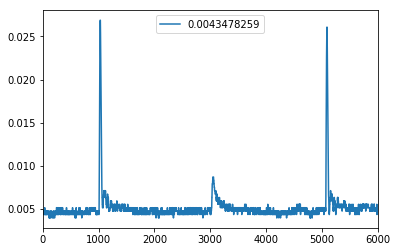

In [8]:
datanew[0:6000].plot()

In [9]:
datanew.shape

(15232499, 1)

In [10]:
data_droped =datanew[0:15232000]

In [11]:
data_droped.shape

(15232000, 1)

In [12]:
dataframe_reshape =pd.DataFrame(data_droped.values.reshape(7616,2000))

In [13]:
dataframe_reshape.shape

(7616, 2000)

In [116]:
iplot([{
    'y': dataframe.iloc[col],
}  for col in range(200,300)])

In [34]:
iplot([{'y': dataframe_reshape.iloc[0:15000]}])

TypeError: Object of type 'DataFrame' is not JSON serializable

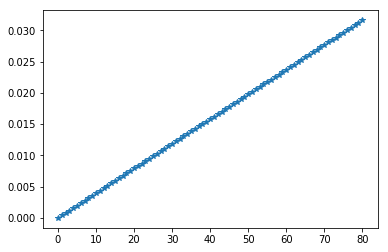

In [52]:
plt.plot(pd.Series(dataframe_reshape.values.ravel()).sort_values().unique(),'*')

In [97]:
dataframemin = dataframe.loc[dataframe['Label'] == 'oxigenio'].iloc[:,1010:1050]
datafreq = pd.DataFrame(index=np.sort(pd.unique(dataframemin.loc[:, dataframemin.columns != 'Label'].values.ravel())),columns=range(0,40))

In [105]:
datafreq

,0,1,2,3,4,5,6,7,8,9,...,1990,1991,1992,1993,1994,1995,1996,1997,1998,1999
0.003557,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0.003953,8.0,8.0,14.0,12.0,40.0,5.0,18.0,7.0,7.0,4.0,...,0.0,0.0,0.0,5.0,0.0,0.0,0.0,0.0,0.0,10.0
0.004348,354.0,262.0,409.0,234.0,540.0,168.0,418.0,357.0,219.0,360.0,...,65.0,94.0,23.0,96.0,0.0,75.0,24.0,72.0,0.0,110.0
0.004743,1058.0,1021.0,914.0,1061.0,992.0,1040.0,1114.0,1011.0,1101.0,1110.0,...,543.0,498.0,715.0,424.0,358.0,504.0,617.0,506.0,348.0,356.0
0.005138,501.0,596.0,566.0,598.0,373.0,686.0,396.0,473.0,517.0,435.0,...,354.0,369.0,258.0,353.0,539.0,310.0,322.0,360.0,645.0,302.0
0.005534,73.0,104.0,72.0,67.0,47.0,87.0,50.0,133.0,121.0,80.0,...,46.0,36.0,3.0,117.0,93.0,54.0,7.0,36.0,9.0,185.0
0.005929,2.0,3.0,20.0,21.0,4.0,7.0,0.0,15.0,27.0,6.0,...,1.0,3.0,2.0,16.0,0.0,29.0,2.0,7.0,4.0,54.0
0.006324,6.0,1.0,1.0,6.0,5.0,3.0,2.0,2.0,6.0,1.0,...,2.0,0.0,1.0,1.0,5.0,0.0,1.0,0.0,1.0,6.0
0.006719,4.0,2.0,3.0,3.0,3.0,6.0,1.0,1.0,2.0,2.0,...,0.0,1.0,1.0,1.0,0.0,1.0,2.0,2.0,1.0,0.0
0.007115,5.0,2.0,3.0,1.0,4.0,3.0,2.0,3.0,1.0,5.0,...,1.0,1.0,1.0,0.0,1.0,2.0,0.0,1.0,2.0,1.0


In [101]:
for i in range(0,40):
    d = dataframe.loc[i].value_counts()
    datafreq[i] = d

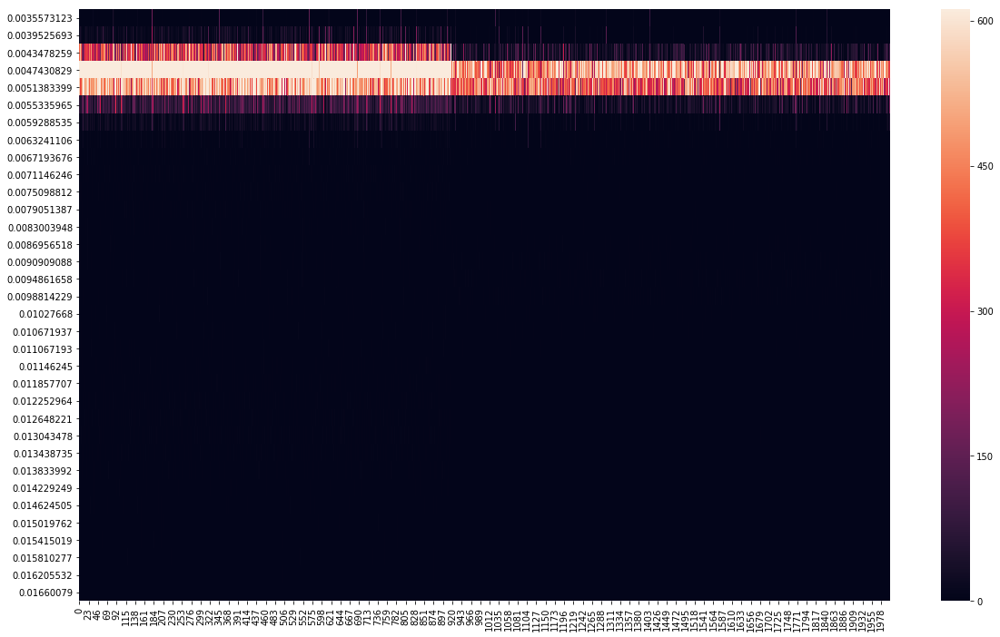

In [107]:
plt.figure(figsize=(20,12))
datafreq.fillna(0,inplace=True)
sns.heatmap(datafreq,robust=True)

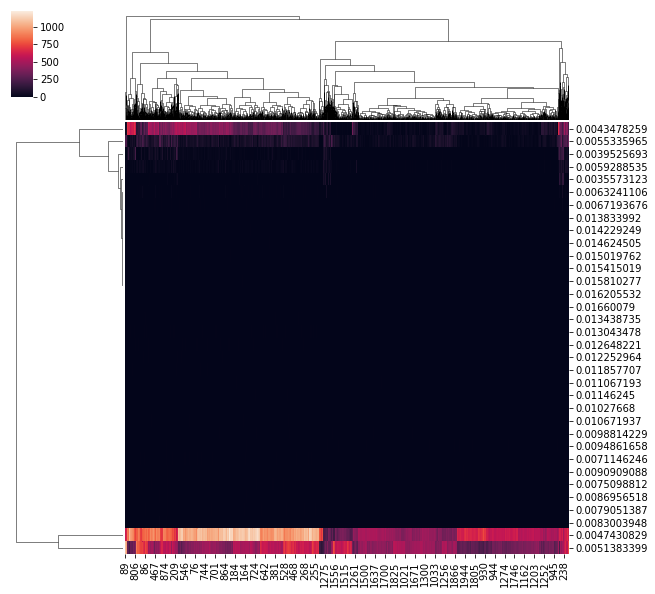

In [106]:
plt.figure(figsize=(20,12))
sns.clustermap(datafreq)

IndexError: boolean index did not match indexed array along dimension 0; dimension is 34 but corresponding boolean dimension is 68000

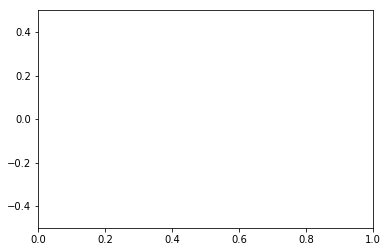

In [114]:
sns.swarmplot(data=datafreq,)

In [17]:
from wavelets import WaveletAnalysis
import numpy as np

In [28]:
def plot_wavelet(data,idx):
    
    dt = 0.1
    wa = WaveletAnalysis(data, dt=dt)
    power = wa.wavelet_power
    scales = wa.scales
    t = wa.time
    rx = wa.reconstruction()
    plt.figure(figsize=(12,8))
    fig, (ax,ax1) = plt.subplots(2,1,sharey=True)
    T, S = np.meshgrid(t, scales)
    ax1.plot(data)
    ax1.set_yscale('linear')
    ax.contourf(T, S, power, 100)
    ax.set_yscale('log')
    fig.savefig('figure/test_wavelet_power_{0}.png'.format(idx))

C:\Users\Apolo\Anaconda3\lib\site-packages\matplotlib\pyplot.py:524: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



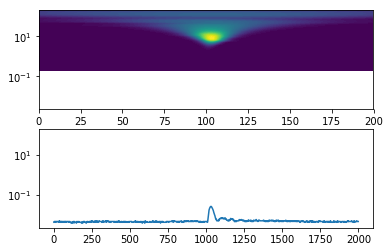

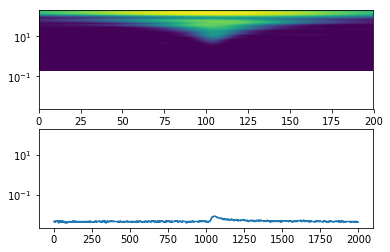

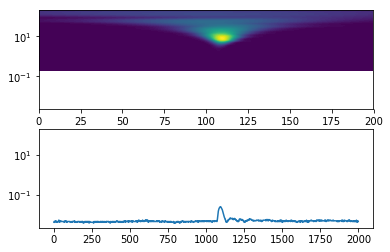

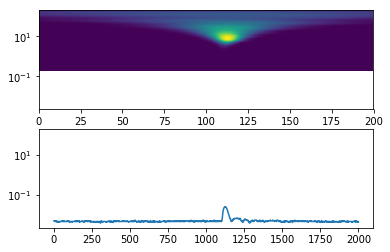

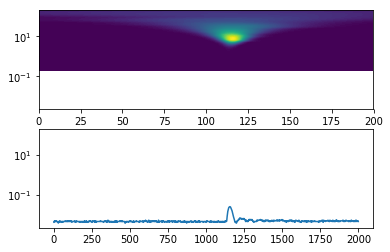

...

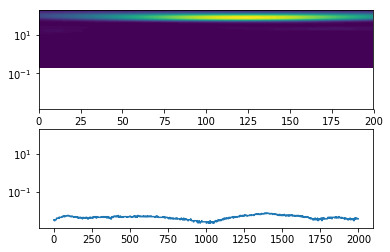

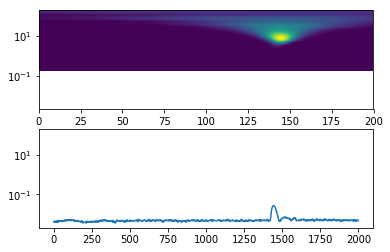

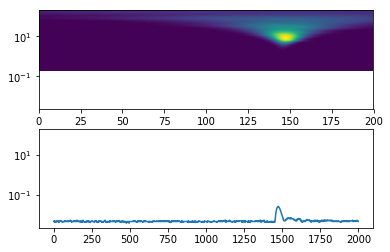

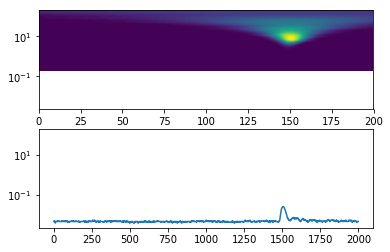

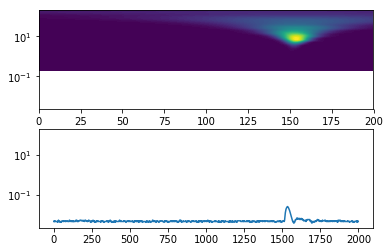

In [30]:
for idx in range(0,1000):
    plot_wavelet(dataframe_reshape.iloc[idx].values,idx)

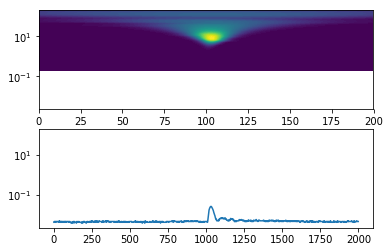

In [29]:
plot_wavelet(dataframe_reshape.iloc[0].values,0)